In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# !cd /content/drive/MyDrive/REVA/RSPI

In [ ]:
# !ls /content/drive/MyDrive/REVA/RSPI/images/train
#!mkdir /content/drive/MyDrive/REVA/RSPI/images/val
#!mkdir /content/drive/MyDrive/REVA/RSPI/labels/train
#!mkdir /content/drive/MyDrive/REVA/RSPI/labels/val


In [ ]:
#!cp /content/drive/MyDrive/REVA/RSPI/train/images/* /content/drive/MyDrive/REVA/RSPI/images/train/

In [ ]:
#!cp /content/drive/MyDrive/REVA/RSPI/train/labels/* /content/drive/MyDrive/REVA/RSPI/labels/train/
#!cp /content/drive/MyDrive/REVA/RSPI/valid/images/* /content/drive/MyDrive/REVA/RSPI/images/val/
#!cp /content/drive/MyDrive/REVA/RSPI/valid/labels/* /content/drive/MyDrive/REVA/RSPI/labels/val/

In [ ]:
!cat /content/drive/MyDrive/REVA/RSPI/rspi_data.yaml

path: /content/drive/MyDrive/REVA/RSPI  # dataset root dir
train: images/train  # train images (relative to 'path') 4 images
val: images/val  # val images (relative to 'path') 4 images
test:  /content/drive/MyDrive/REVA/RSPI/test # test images (optional)
misc: /content/drive/MyDrive/REVA/RSPI/misc # miscellaneous images (optional)

# Classes
names:
  0: nescafe
  1: sprite

In [ ]:
!pip install ultralytics

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#prediction with detection yolov8 nano
#prediction with detection yolov8 small
#prediction with detection yolov8 medium


In [ ]:
from ultralytics import YOLO
 # load a pretrained model (recommended for training)


In [ ]:
model = YOLO('yolov8n.pt')

In [ ]:
img = '/content/drive/MyDrive/REVA/RSPI/misc/IMG-20230101-WA0008.jpg'
inputs = [img]  # list of numpy arrays
#results = model(inputs)  # list of Results objects

In [ ]:
from google.colab.patches import cv2_imshow

In [ ]:
results = model.predict(inputs, save=True, imgsz=1280, conf=0.5)


0: 1280x1280 4 bottles, 1 refrigerator, 21.4ms
Speed: 5.1ms preprocess, 21.4ms inference, 1.8ms postprocess per image at shape (1, 3, 1280, 1280)
Results saved to runs/detect/predict2


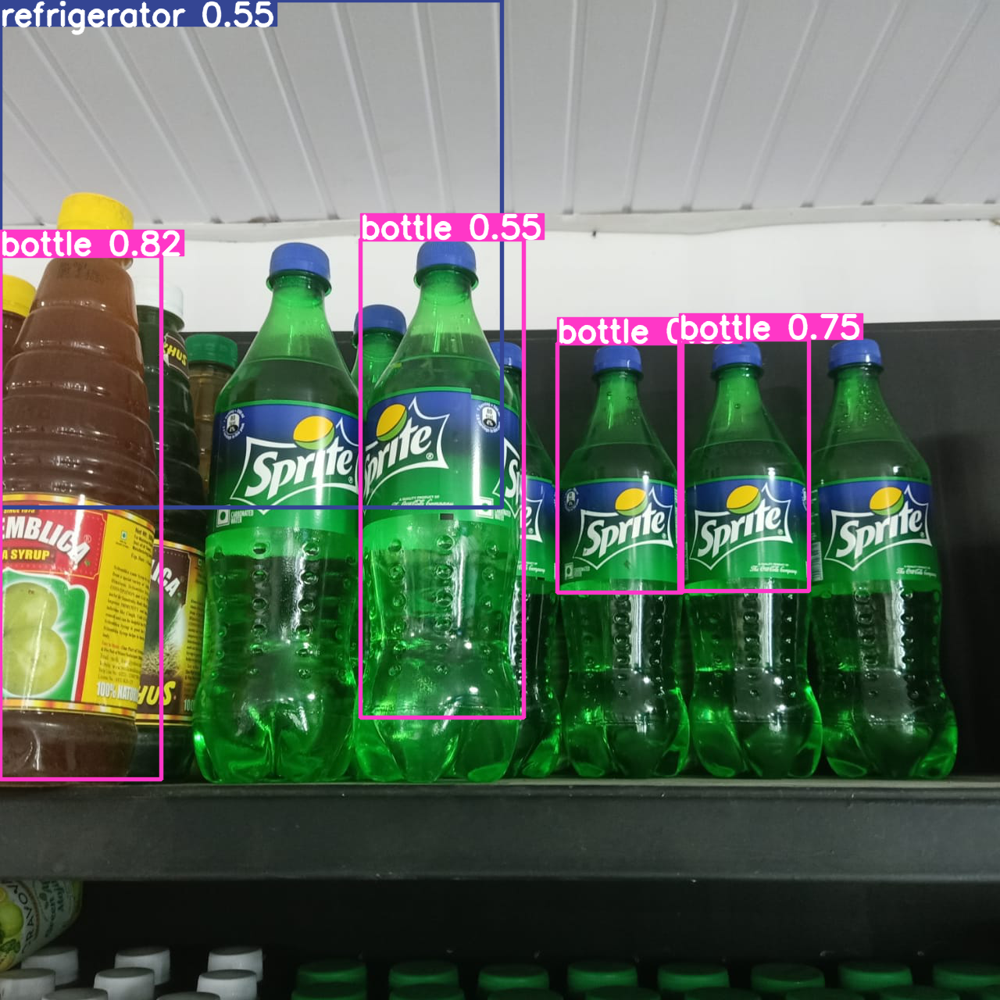

In [ ]:
cv2_imshow( results[0].plot())

In [ ]:
model.info()

YOLOv8n summary (fused): 168 layers, 3151904 parameters, 0 gradients


(3151904, 0.0)

In [ ]:
results = model.train(data='/content/drive/MyDrive/REVA/RSPI/rspi_data.yaml',
                      imgsz=1280,
                      epochs=200,
                      batch=4,
                      patience=20, save=True, save_period=1,
                      project= '/content/drive/MyDrive/REVA/RSPI', name='yolov8n_v8_exp')

Ultralytics YOLOv8.0.104 🚀 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/drive/MyDrive/REVA/RSPI/rspi_data.yaml, epochs=200, patience=20, batch=4, imgsz=1280, save=True, save_period=1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/REVA/RSPI, name=yolov8n_v8_exp, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optim

Validation

In [ ]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [ ]:
model = YOLO('/content/drive/MyDrive/REVA/RSPI/yolov8n_v8_exp/weights/best.pt')  # load a custom model


In [ ]:

# Validate the model
metrics = model.val()  # no arguments needed, dataset and settings remembered
metrics.box.map    # map50-95
metrics.box.map50  # map50
metrics.box.map75  # map75
metrics.box.maps   # a list contains map50-95 of each category

Ultralytics YOLOv8.0.104 🚀 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3006038 parameters, 0 gradients
val: Scanning /content/drive/MyDrive/REVA/RSPI/labels/val.cache... 17 images, 0 backgrounds, 0 corrupt: 100%|██████████| 17/17 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.34s/it]
                   all         17         32      0.881      0.793      0.871      0.542
               nescafe         17          5          1      0.957      0.995      0.682
                sprite         17         27      0.761       0.63      0.747      0.403
Speed: 48.6ms preprocess, 29.4ms inference, 0.0ms loss, 2.6ms postprocess per image
Results saved to runs/detect/val


0.5423501608859329

0.8710029010766229

0.681079788364545

array([    0.68152,     0.40318])

In [ ]:
source = '/content/drive/MyDrive/REVA/RSPI/test'
results_test = model.predict( source, save=True, imgsz=1280, conf=0.30)


image 1/17 /content/drive/MyDrive/REVA/RSPI/test/c_19.jpg: 1280x1280 2 nescafes, 20.1ms
image 2/17 /content/drive/MyDrive/REVA/RSPI/test/c_21.jpg: 1280x1280 1 nescafe, 19.4ms
image 3/17 /content/drive/MyDrive/REVA/RSPI/test/c_22.jpg: 1280x1280 2 nescafes, 19.4ms
image 4/17 /content/drive/MyDrive/REVA/RSPI/test/c_23.jpg: 1280x1280 1 nescafe, 19.4ms
image 5/17 /content/drive/MyDrive/REVA/RSPI/test/c_24.jpg: 1280x1280 1 nescafe, 19.4ms
image 6/17 /content/drive/MyDrive/REVA/RSPI/test/s_108.jpg: 1280x1280 12 sprites, 19.4ms
image 7/17 /content/drive/MyDrive/REVA/RSPI/test/s_109.jpg: 1280x1280 4 sprites, 19.4ms
image 8/17 /content/drive/MyDrive/REVA/RSPI/test/s_110.jpg: 1280x1280 3 sprites, 19.4ms
image 9/17 /content/drive/MyDrive/REVA/RSPI/test/s_111.jpg: 1280x1280 1 nescafe, 4 sprites, 19.4ms
image 10/17 /content/drive/MyDrive/REVA/RSPI/test/s_112.jpg: 1280x1280 4 sprites, 19.4ms
image 11/17 /content/drive/MyDrive/REVA/RSPI/test/s_113.jpg: 1280x1280 9 sprites, 19.5ms
image 12/17 /content

In [ ]:
import numpy as np


In [ ]:

for result in results_test :
  unique, count = np.unique(result.boxes.cpu().cls.numpy(), return_counts=True)
  unique = unique.astype(np.uint8)
  for k, v in dict(zip(unique, count)).items() :
    clsname = result.names.get(k)
    print(f"{v} {clsname} detected")
  print()

2 nescafe detected

1 nescafe detected

2 nescafe detected

1 nescafe detected

1 nescafe detected

12 sprite detected

4 sprite detected

3 sprite detected

1 nescafe detected
4 sprite detected

4 sprite detected

9 sprite detected

4 sprite detected

3 sprite detected

3 sprite detected

4 sprite detected

18 sprite detected

4 sprite detected



In [ ]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding



In [ ]:
!cp /content/runs/detect/predict3/* /content/drive/MyDrive/REVA/RSPI/test/predict

In [ ]:
# prediction at cofidence of 0.5
source = '/content/drive/MyDrive/REVA/RSPI/test'
results_test = model.predict( source, save=True, imgsz=1280, conf=0.50)


image 1/17 /content/drive/MyDrive/REVA/RSPI/test/c_19.jpg: 1280x1280 1 nescafe, 19.6ms
image 2/17 /content/drive/MyDrive/REVA/RSPI/test/c_21.jpg: 1280x1280 1 nescafe, 19.4ms
image 3/17 /content/drive/MyDrive/REVA/RSPI/test/c_22.jpg: 1280x1280 2 nescafes, 19.4ms
image 4/17 /content/drive/MyDrive/REVA/RSPI/test/c_23.jpg: 1280x1280 1 nescafe, 19.4ms
image 5/17 /content/drive/MyDrive/REVA/RSPI/test/c_24.jpg: 1280x1280 1 nescafe, 19.5ms
image 6/17 /content/drive/MyDrive/REVA/RSPI/test/s_108.jpg: 1280x1280 11 sprites, 19.4ms
image 7/17 /content/drive/MyDrive/REVA/RSPI/test/s_109.jpg: 1280x1280 3 sprites, 19.5ms
image 8/17 /content/drive/MyDrive/REVA/RSPI/test/s_110.jpg: 1280x1280 3 sprites, 19.4ms
image 9/17 /content/drive/MyDrive/REVA/RSPI/test/s_111.jpg: 1280x1280 3 sprites, 19.6ms
image 10/17 /content/drive/MyDrive/REVA/RSPI/test/s_112.jpg: 1280x1280 4 sprites, 19.5ms
image 11/17 /content/drive/MyDrive/REVA/RSPI/test/s_113.jpg: 1280x1280 5 sprites, 19.4ms
image 12/17 /content/drive/MyDri

In [ ]:
# store the prediction at 0.5
!cp /content/runs/detect/predict3/* /content/drive/MyDrive/REVA/RSPI/test/predict_conf5

In [ ]:
# prediction at cofidence of 0.55 of test
source = '/content/drive/MyDrive/REVA/RSPI/test'
results_test = model.predict( source,
                             save=True,
                             imgsz=1280,
                             conf=0.55,
                             iou=0.8,
                             show=True)

WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()


image 1/17 /content/drive/MyDrive/REVA/RSPI/test/c_19.jpg: 1280x1280 1 nescafe, 1005.9ms
image 2/17 /content/drive/MyDrive/REVA/RSPI/test/c_21.jpg: 1280x1280 1 nescafe, 841.0ms
image 3/17 /content/drive/MyDrive/REVA/RSPI/test/c_22.jpg: 1280x1280 2 nescafes, 1284.8ms
image 4/17 /content/drive/MyDrive/REVA/RSPI/test/c_23.jpg: 1280x1280 1 nescafe, 1267.1ms
image 5/17 /content/drive/MyDrive/REVA/RSPI/test/c_24.jpg: 1280x1280 2 nescafes, 1048.8ms
image 6/17 /content/drive/MyDrive/REVA/RSPI/test/s_108.jpg: 1280x1280 10 sprites, 823.5ms
image 7/17 /content/drive/MyDrive/REVA/RSPI/test/s_109.jpg: 1280x1280 3 sprites, 828.8ms
image 8/17 /content/drive/MyDrive/REVA/RSPI/test/s_110.jpg: 1280x1280 3 sprites, 841.6ms
image 9/17 /content/drive/MyDrive/REVA/RSPI/test/s_111.jpg: 1280x1280 3 sprites, 820.4ms
image 10/17 /content/drive/MyDrive/REVA/RSPI/test/s_112.jpg: 1280x1280 4 sprites, 842.2ms
image 11/17 /content/drive/MyDri

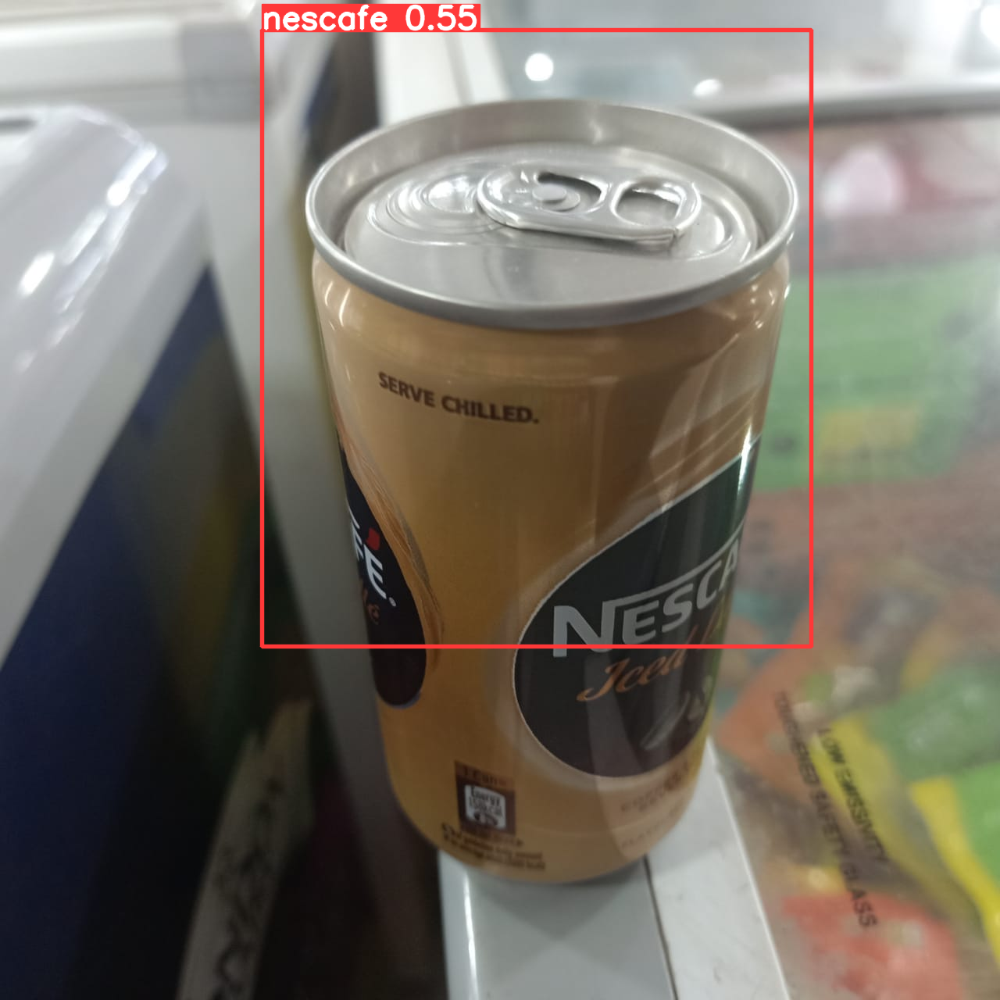

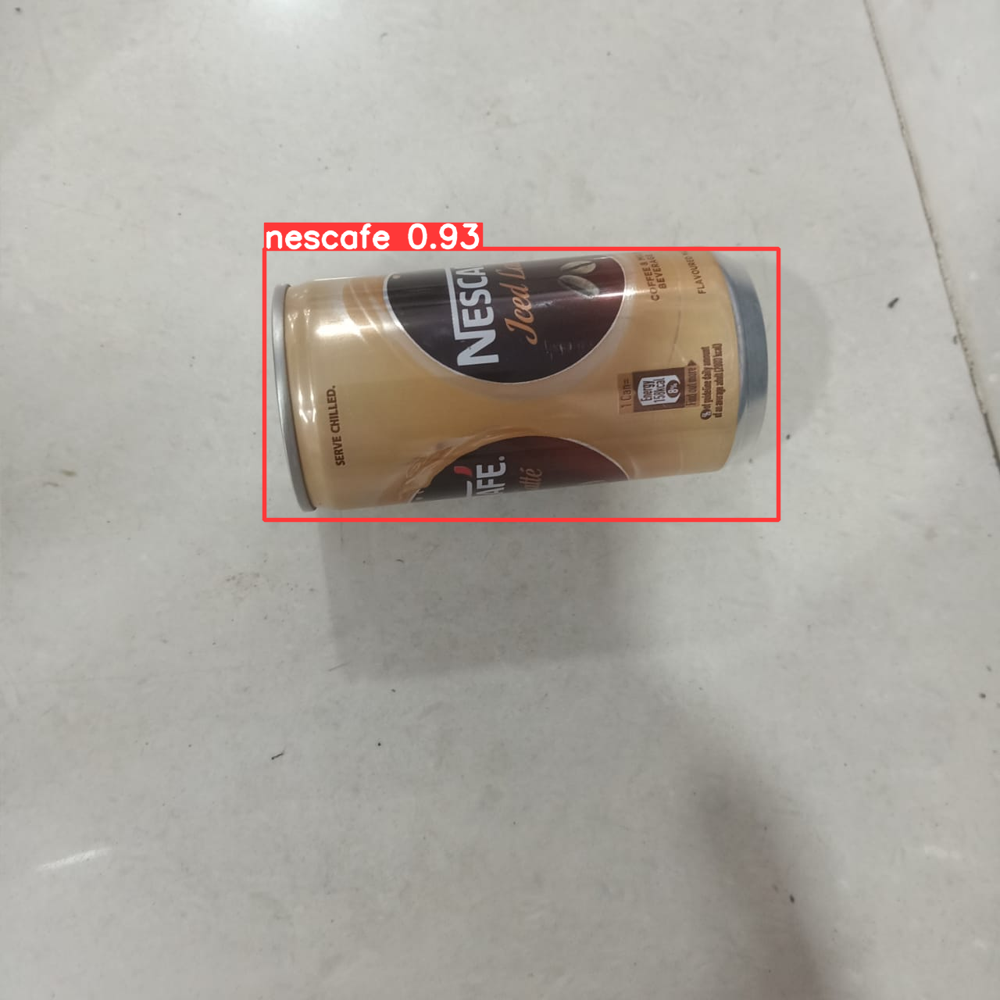

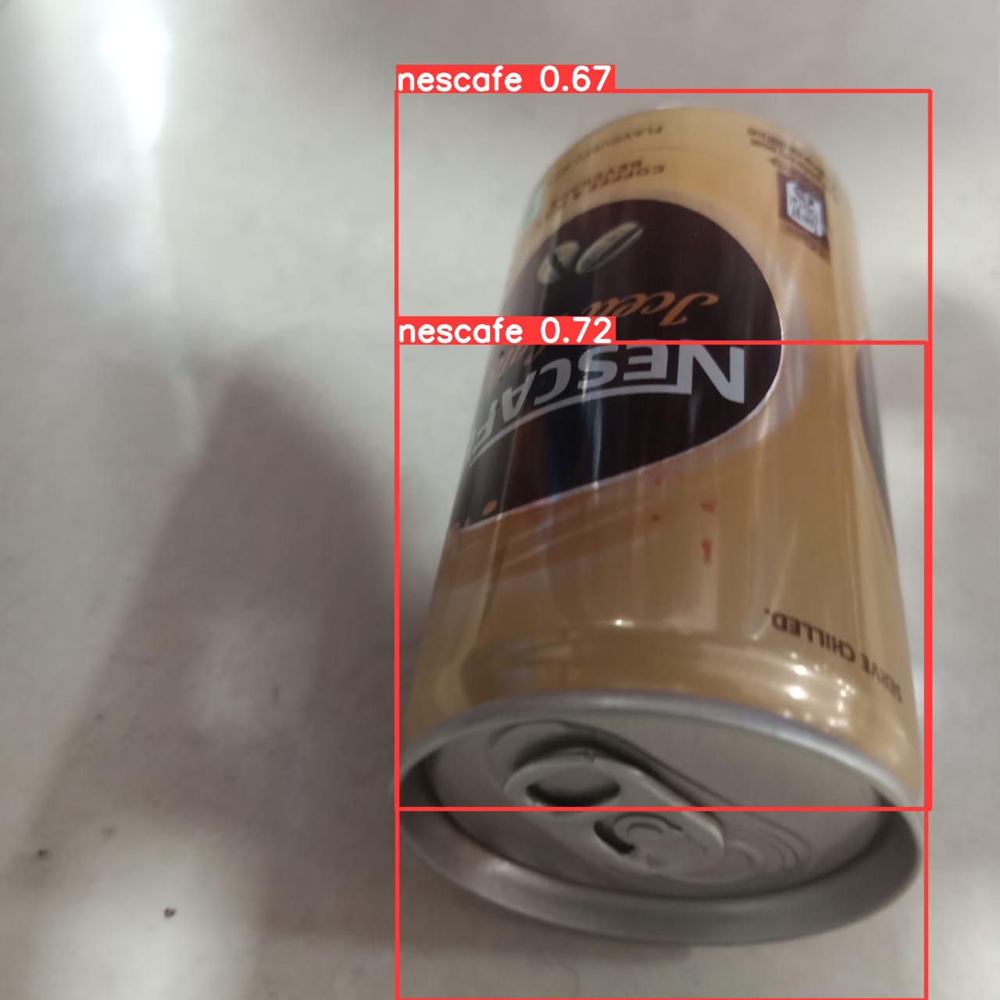

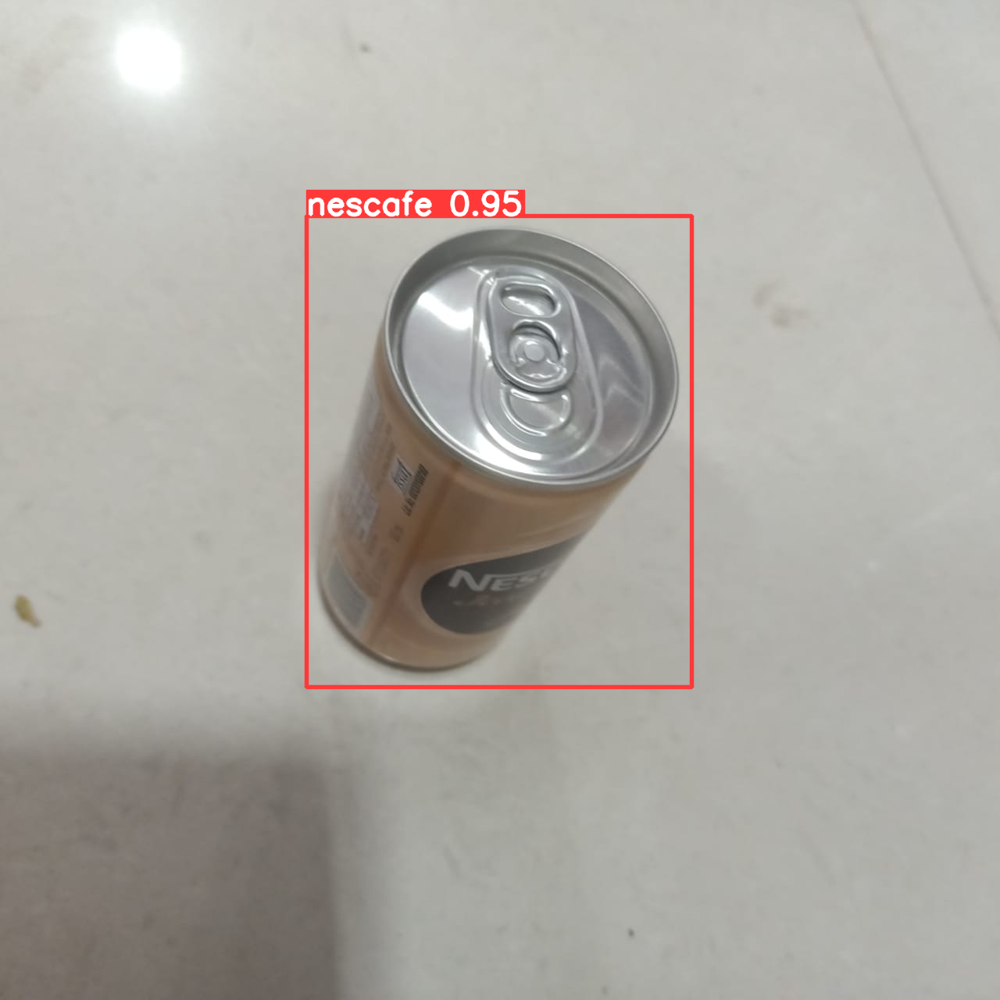

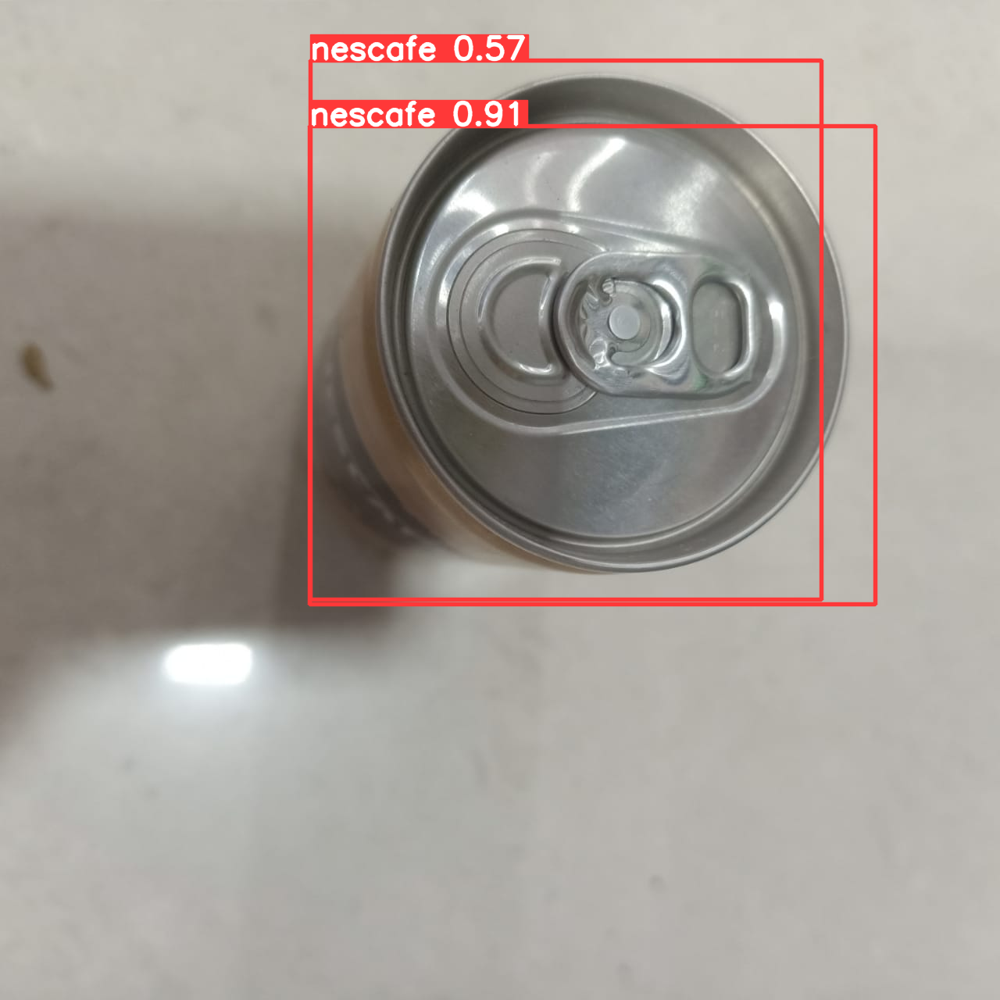

...

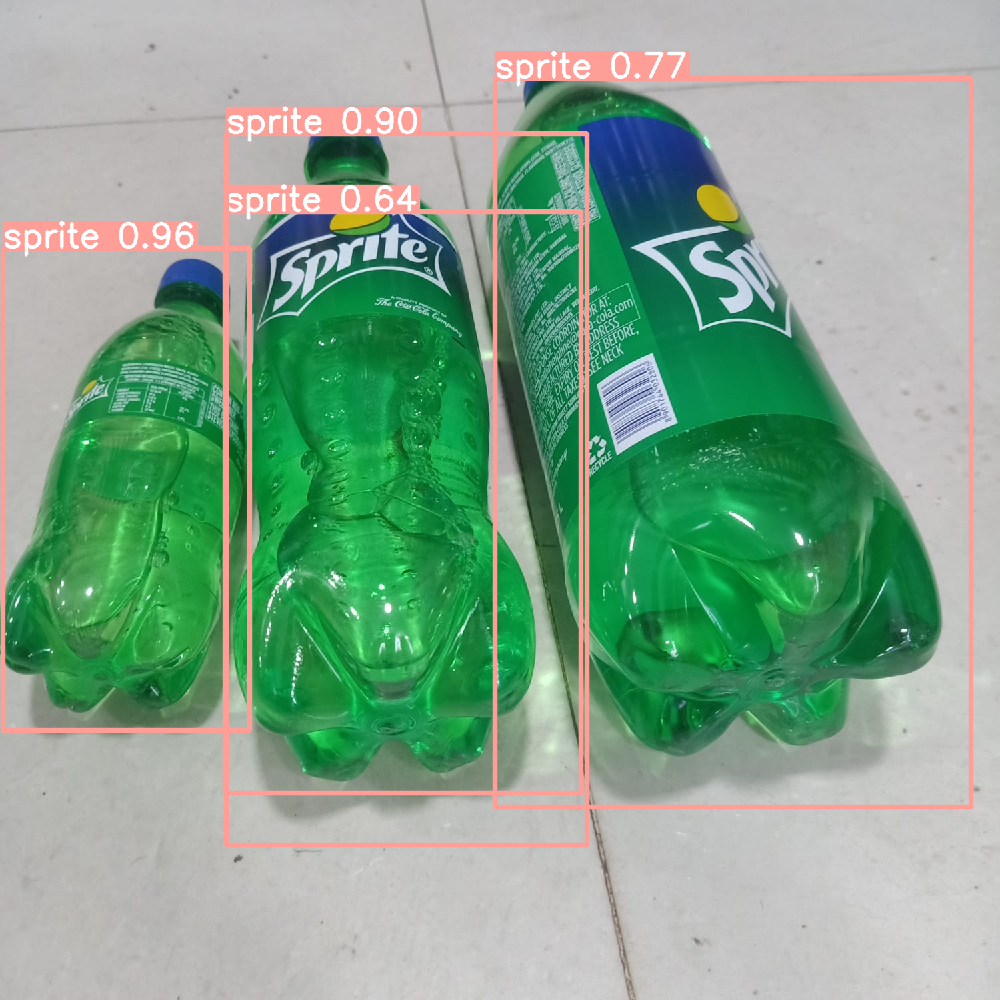

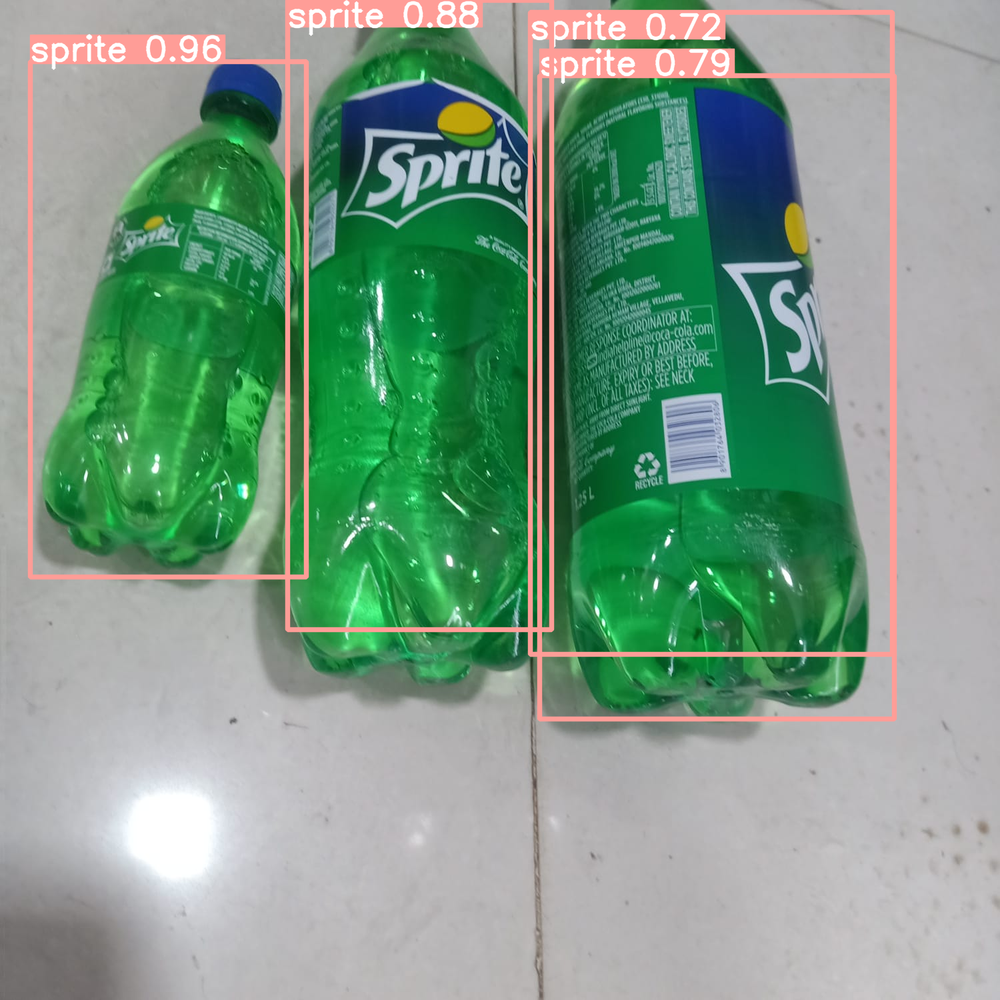

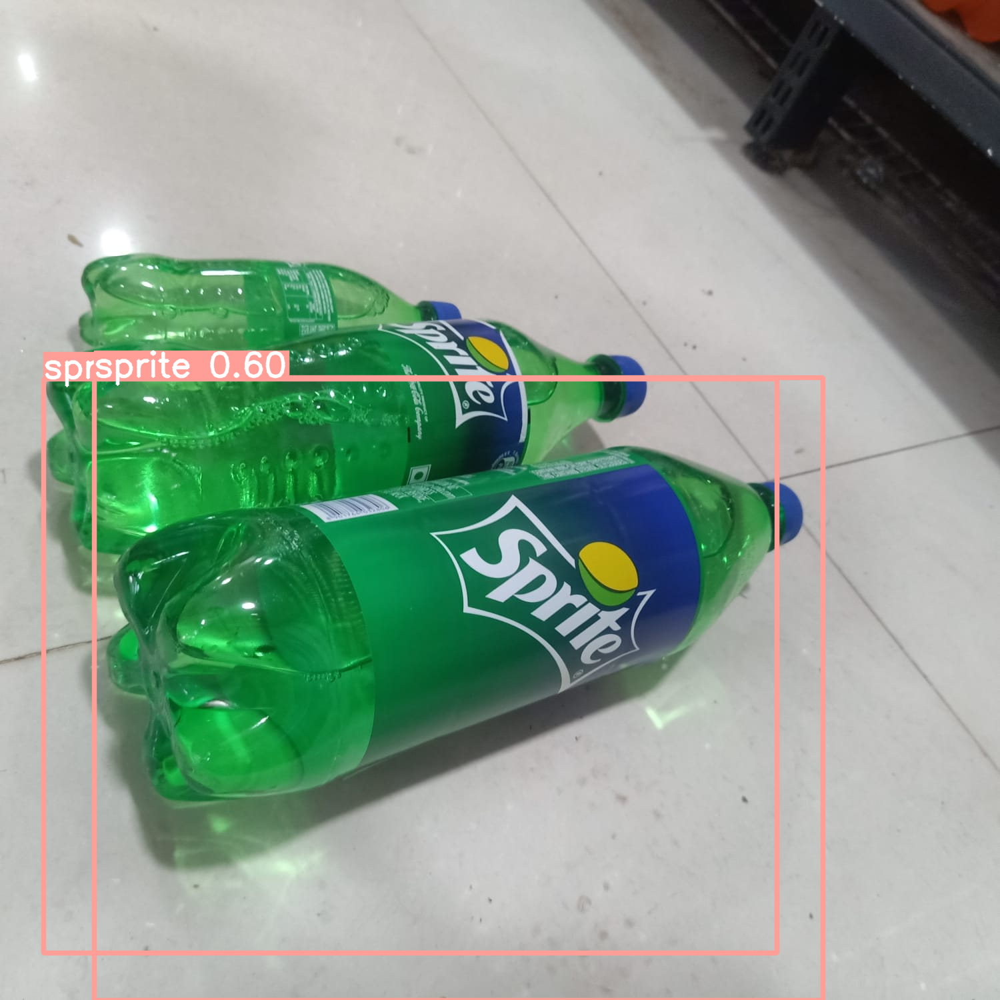

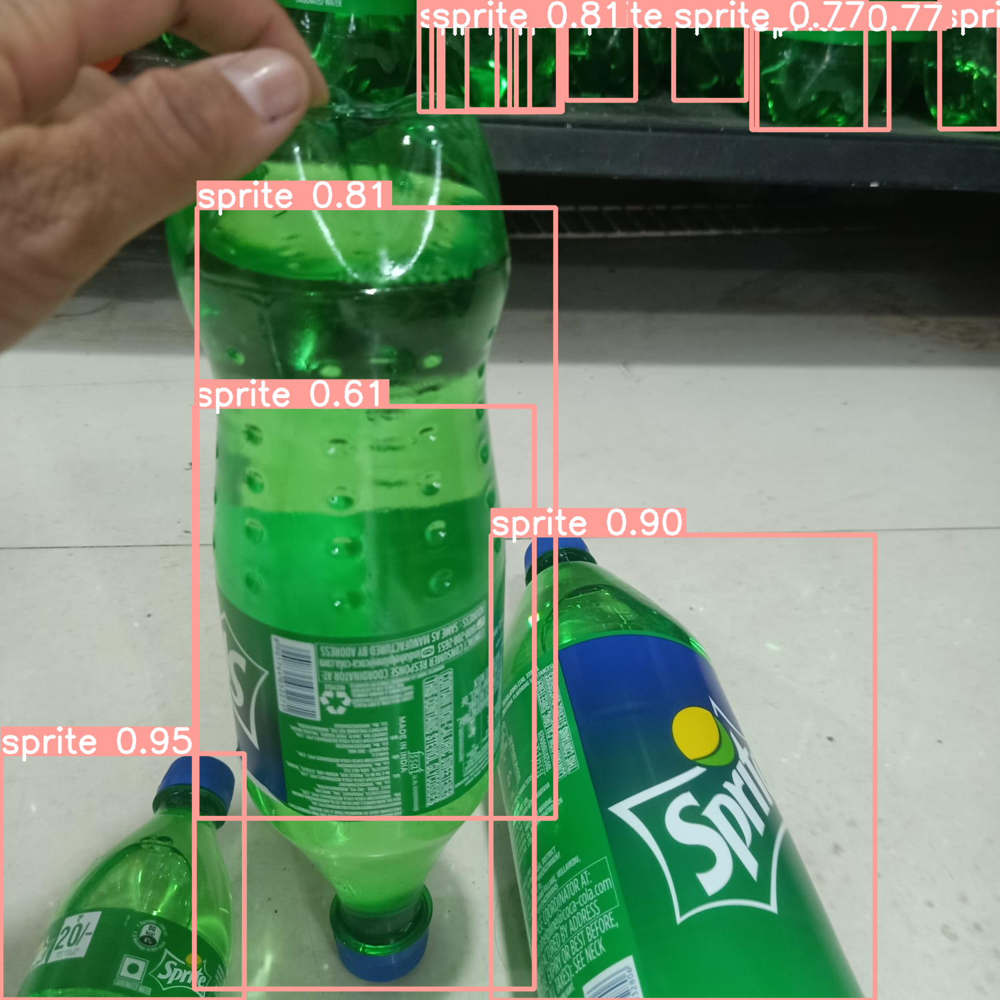

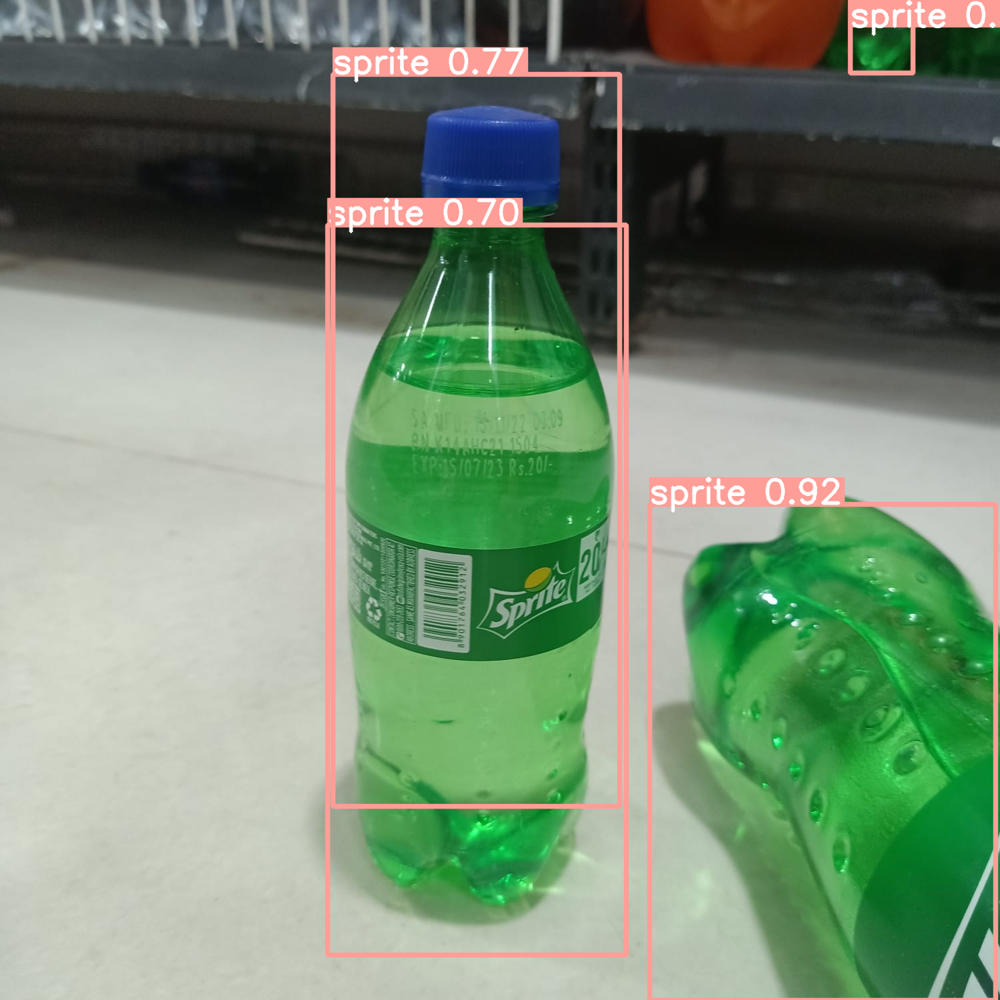

In [ ]:
for result in results_test:
  cv2_imshow( result.plot())

In [ ]:
!cp /content/runs/detect/predict/*.jpg /content/drive/MyDrive/REVA/RSPI/test/predict_conf55_iou8/

In [ ]:
!pip install pillow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from PIL import Image

In [ ]:
# prediction at cofidence of 0.55 of misc
source = '/content/drive/MyDrive/REVA/RSPI/misc'
results_misc = model.predict( source,
                             save=True,
                             imgsz=1280,
                             conf=0.55,
                             iou=0.8,
                             show=True)

WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()


image 1/22 /content/drive/MyDrive/REVA/RSPI/misc/IMG-20230101-WA0008.jpg: 1280x1280 1 nescafe, 8 sprites, 1079.9ms
image 2/22 /content/drive/MyDrive/REVA/RSPI/misc/IMG-20230101-WA0012.jpg: 1280x1280 8 sprites, 3237.9ms
image 3/22 /content/drive/MyDrive/REVA/RSPI/misc/IMG-20230101-WA0013.jpg: 1280x1280 10 sprites, 2156.8ms
image 4/22 /content/drive/MyDrive/REVA/RSPI/misc/IMG-20230101-WA0014.jpg: 1280x1280 9 sprites, 1796.2ms
image 5/22 /content/drive/MyDrive/REVA/RSPI/misc/IMG-20230101-WA0015.jpg: 1280x1280 9 sprites, 1807.2ms
image 6/22 /content/drive/MyDrive/REVA/RSPI/misc/IMG-20230101-WA0016.jpg: 1280x1280 8 sprites, 1687.8ms
image 7/22 /content/drive/MyDrive/REVA/RSPI/misc/IMG-20230101-WA0018.jpg: 1280x1280 2 sprites, 1473.6ms
image 8/22 /content/drive/MyDrive/REVA/RSPI/misc/IMG-20230101-WA0019.jpg: 1280x1280 7 sprites, 1393.6ms
image 9/22 /content/drive/MyDrive/REVA/RSPI/misc/IMG-20230101-WA0031.jpg: 1280x12

In [ ]:
Image.show('/content/runs/detect/predict3/IMG-20230101-WA0008.jpg')

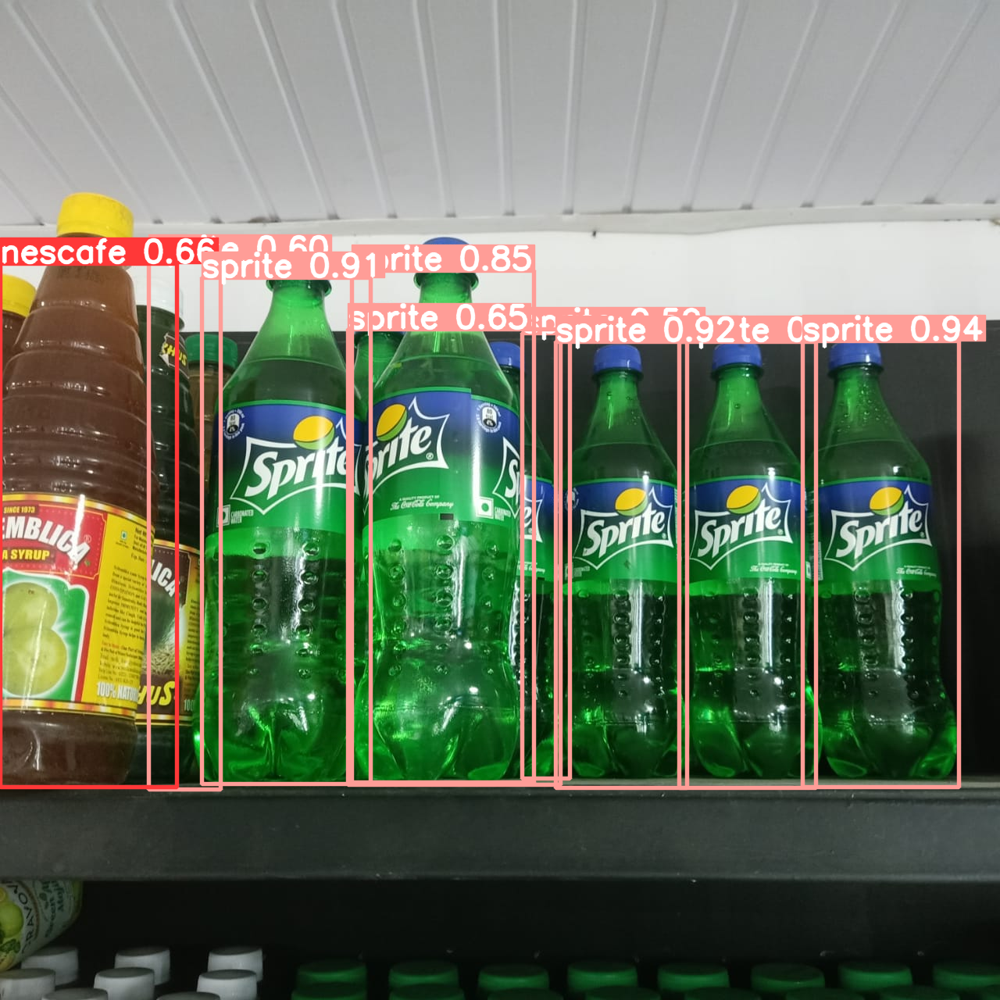

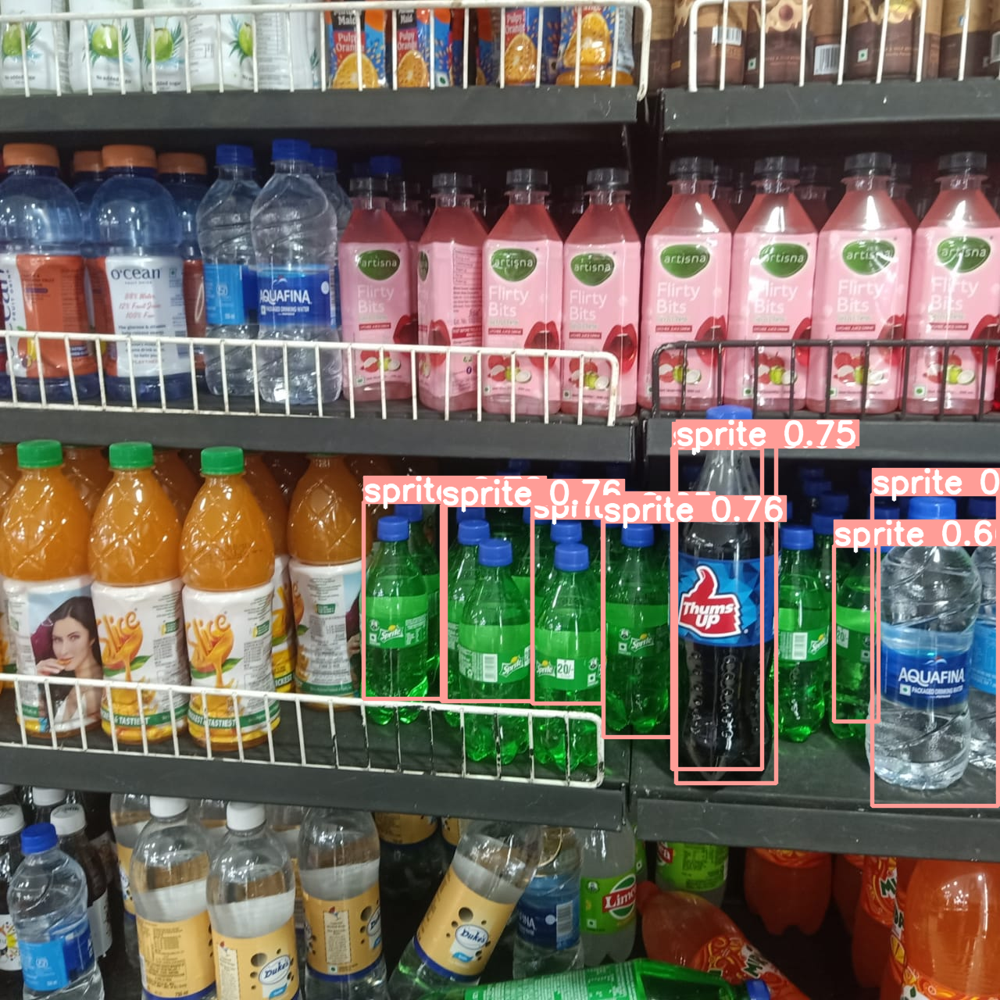

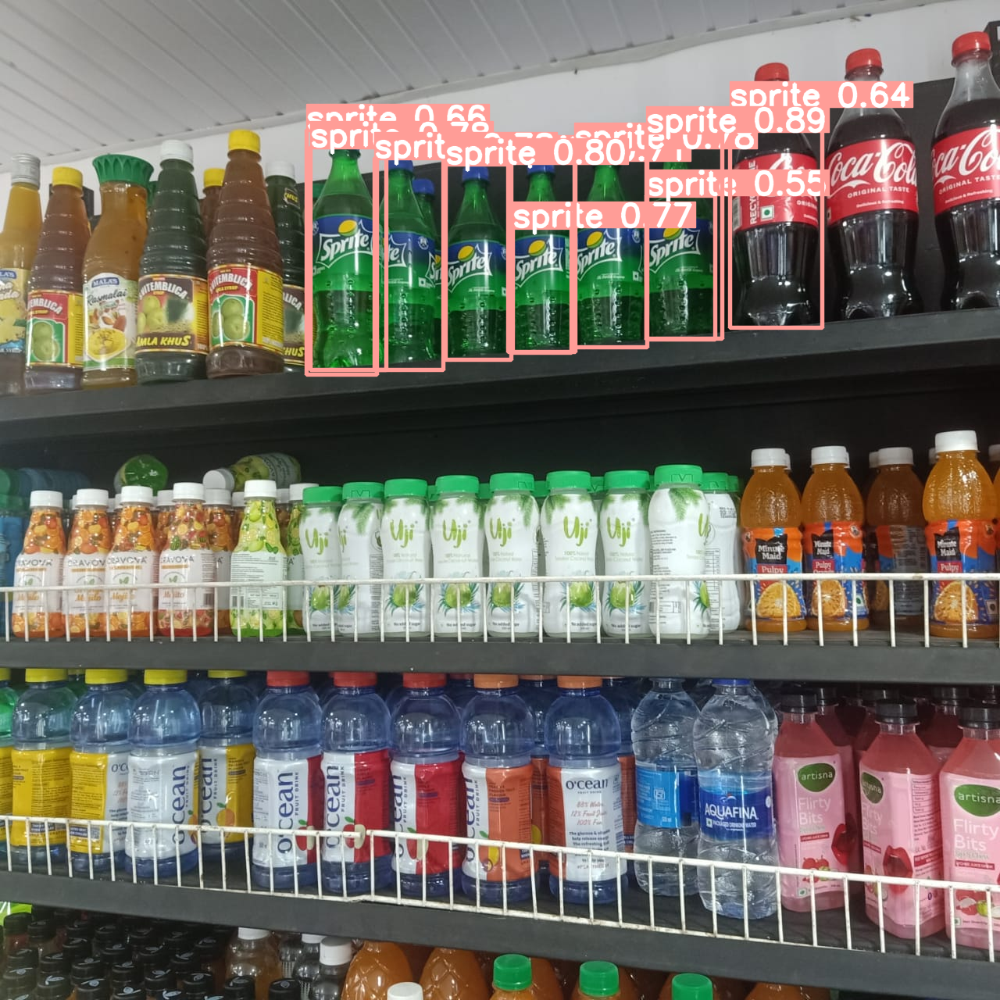

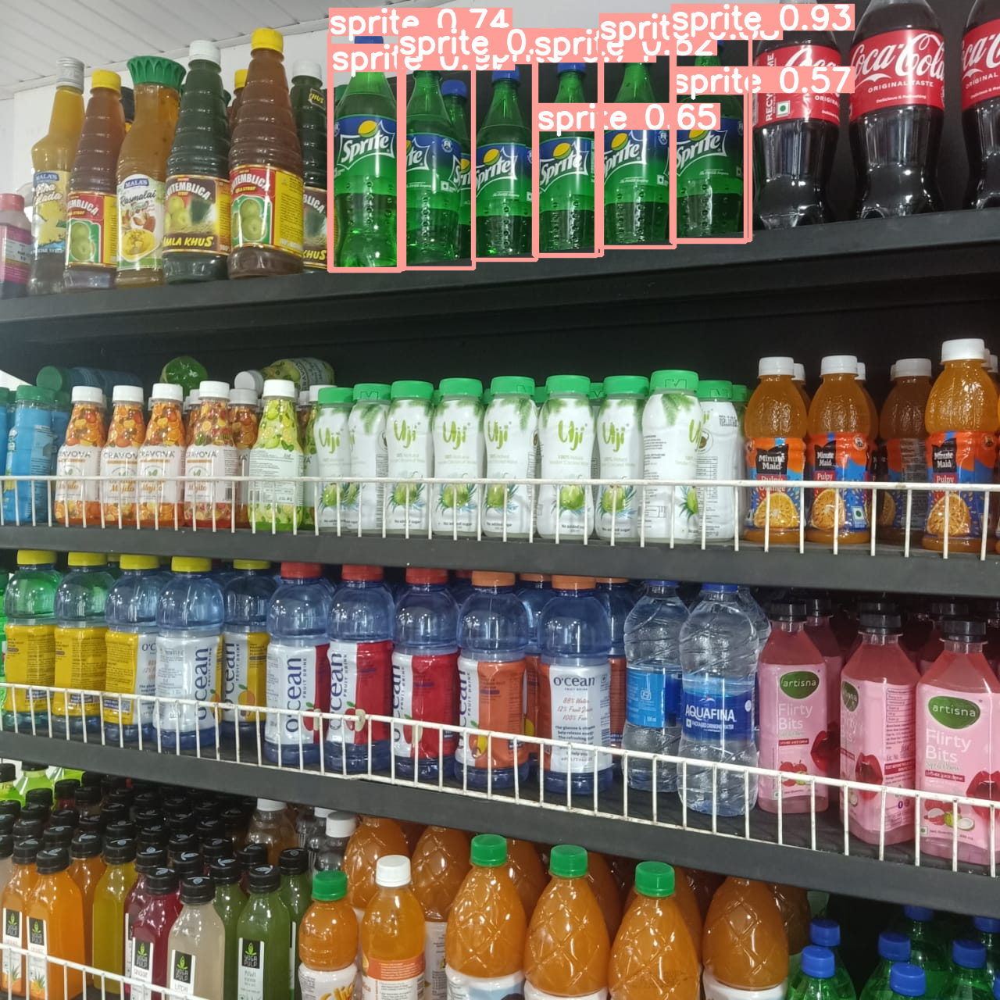

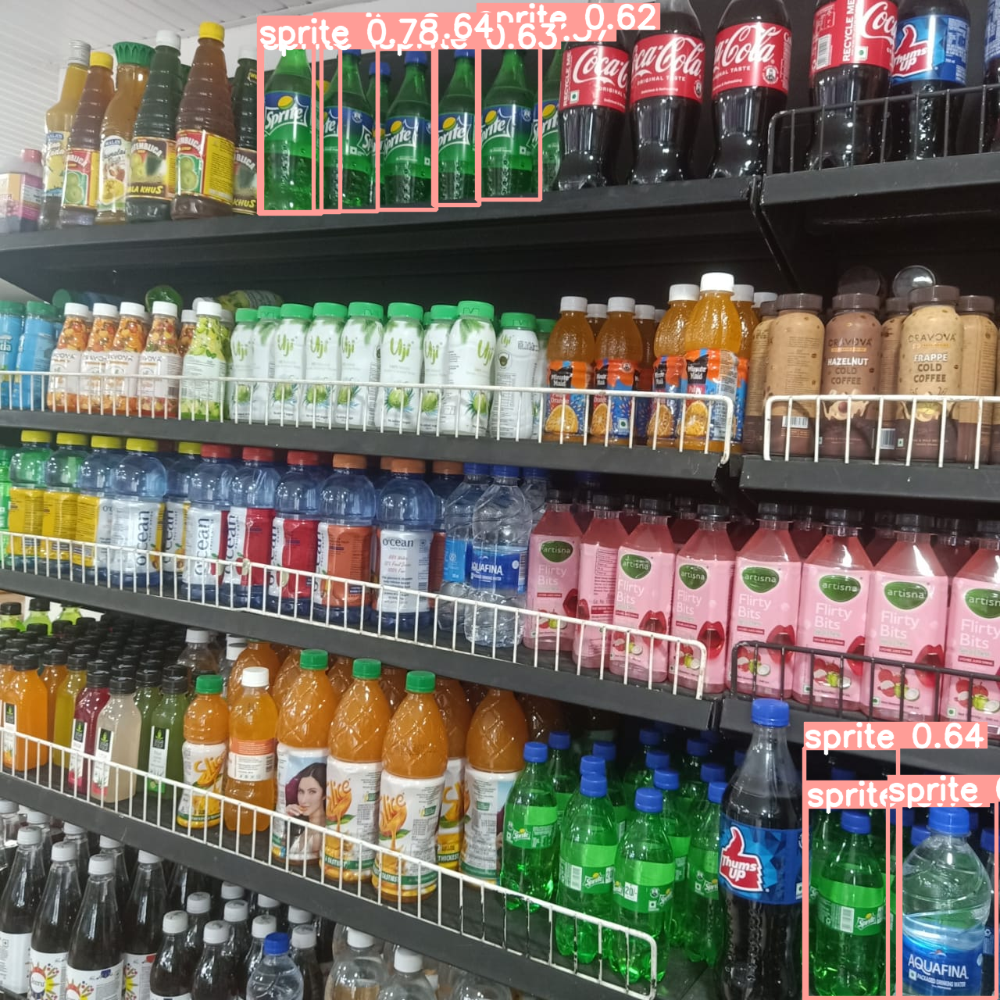

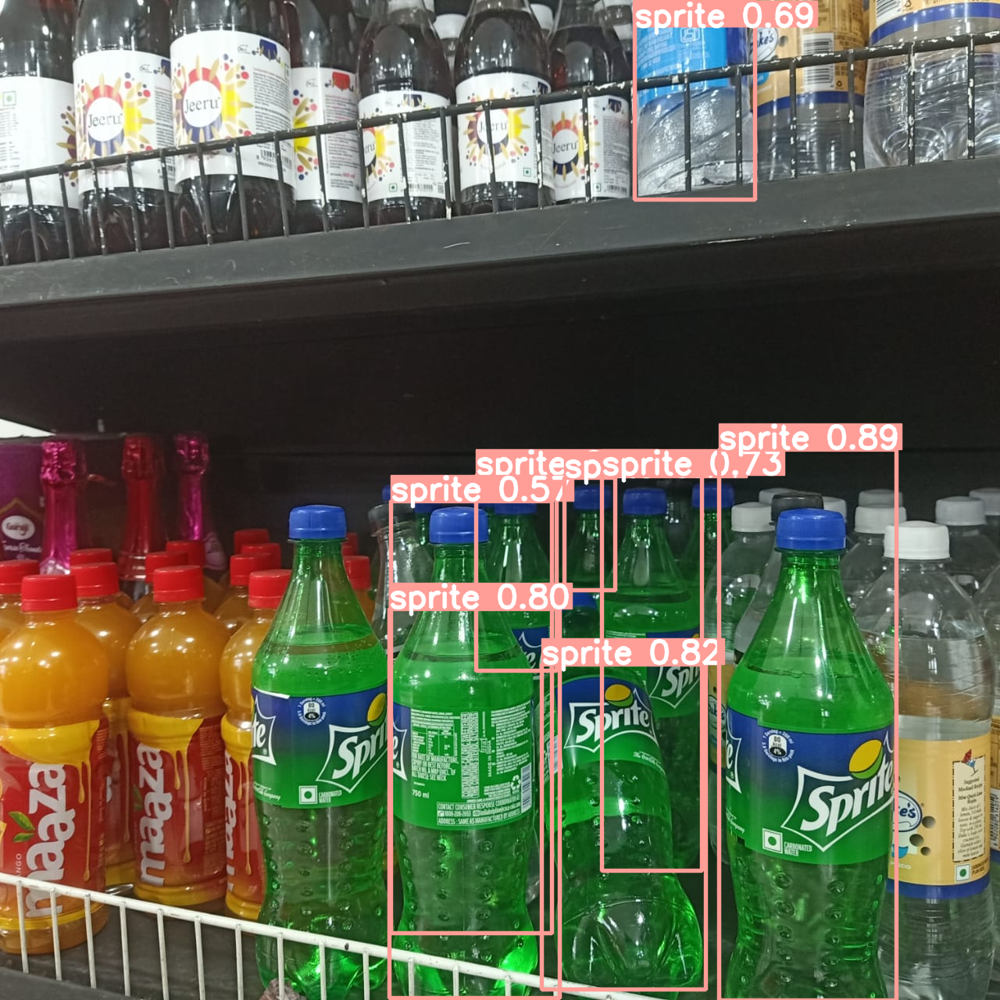

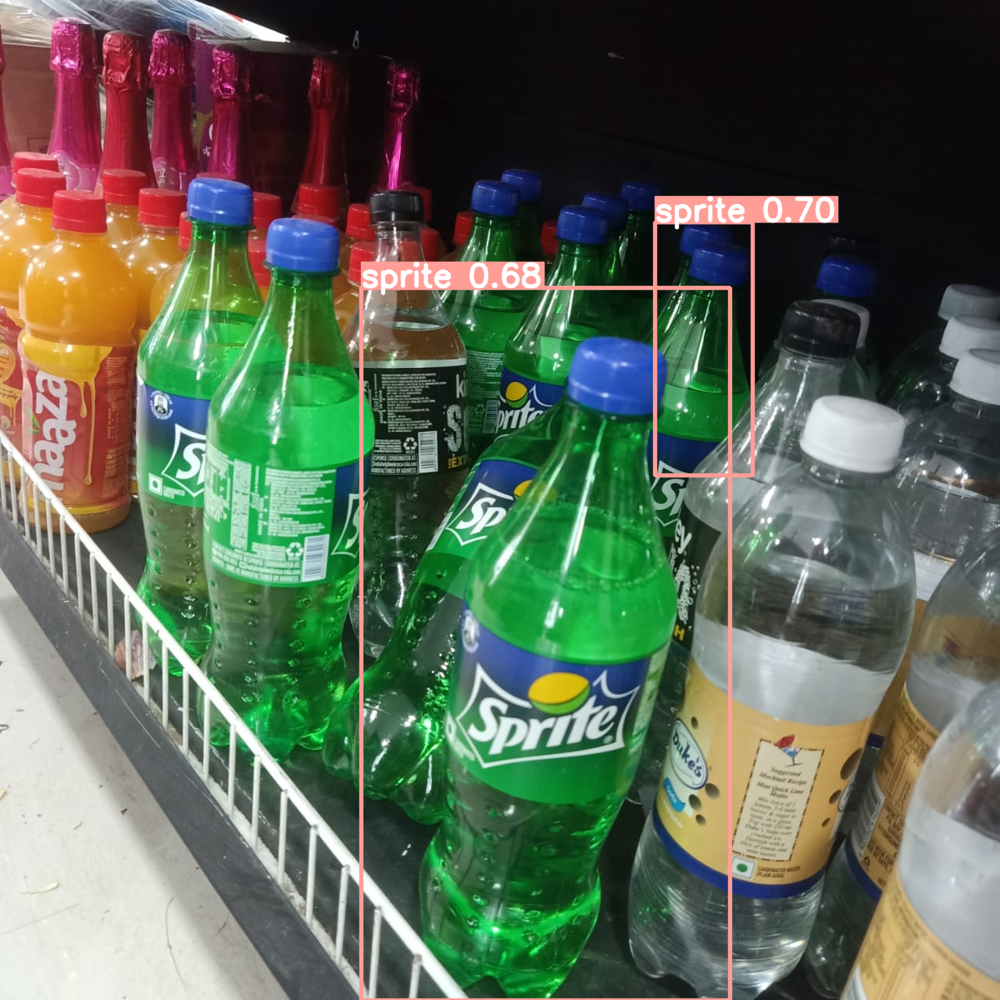

In [ ]:
for result in results_misc:
  cv2_imshow( result.plot())

In [ ]:
!cp /content/runs/detect/predict3/*.jpg /content/drive/MyDrive/REVA/RSPI/misc/predict_conf55_iou8/